In [1]:
from google.cloud import bigquery

bqclient = bigquery.Client.from_service_account_json("musa-509-75492c1cf2ae.json")

In [2]:
import pandas as pd
import geopandas as gpd
import datashader as ds
import numpy as np

import datashader.transfer_functions as tf
import matplotlib.pyplot as plt

from datashader.bundling import connect_edges, hammer_bundle
from datashader.colors import inferno, viridis
from datashader.utils import export_image
from datashader.utils import lnglat_to_meters

from colorcet import palette
from matplotlib import cm

In [3]:
query = """
    SELECT longitude, latitude
    FROM `tidal-digit-291220.safegraph.places`
    WHERE city = 'New York' AND region = 'NY'
        """

In [4]:
df = bqclient.query(query).result().to_dataframe()

In [5]:
X, Y = lnglat_to_meters(df['longitude'], df['latitude'])

df['X'] = X
df['Y'] = Y

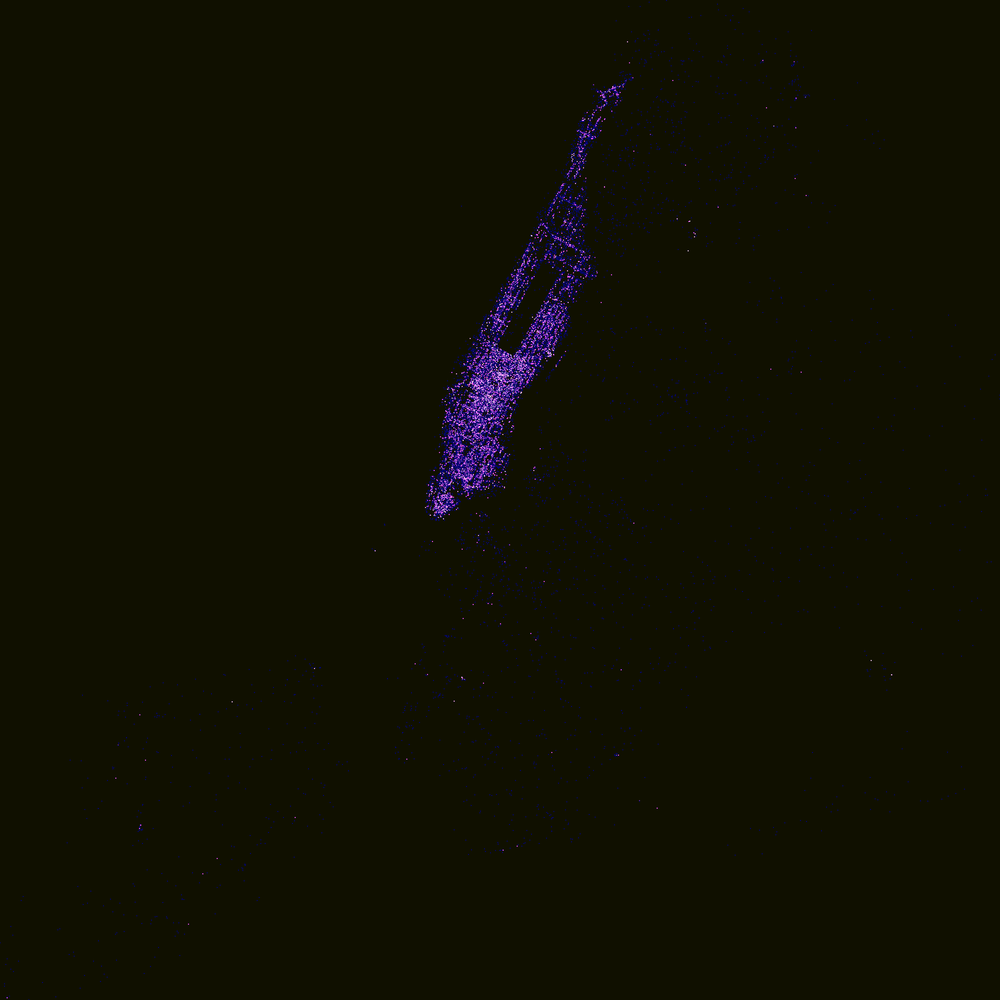

In [6]:
df['outlier_x'] = pd.qcut(df.X, 100, labels=False)
df['outlier_y'] = pd.qcut(df.Y, 100, labels=False)

for i in np.arange(1, 10):
    df = df[(df['X']!=df['X'].min()) & (df['Y']!=df['Y'].min())]
    df = df[(df['X']!=df['X'].max()) & (df['Y']!=df['Y'].max())]

range_x = (df['X'].min(), df['X'].max())
range_y = (df['Y'].min(), df['Y'].max())

wi = int(3000)
hi = int(3000)

cvs = ds.Canvas(plot_width=wi, plot_height=hi, x_range=range_x, y_range=range_y)
agg = cvs.points(df, "X", "Y", agg=ds.count())
img = tf.shade(agg, cmap=palette['CET_L7'][20:], how="eq_hist")
img = tf.spread(img, px=1, how='saturate')
img = tf.set_background(img, "#101000")

img

In [7]:
query = """
    SELECT longitude, latitude
    FROM `tidal-digit-291220.safegraph.places`
    WHERE city = 'Los Angeles' AND region = 'CA'
        """

In [8]:
df = bqclient.query(query).result().to_dataframe()

In [9]:
X, Y = lnglat_to_meters(df['longitude'], df['latitude'])

df['X'] = X
df['Y'] = Y

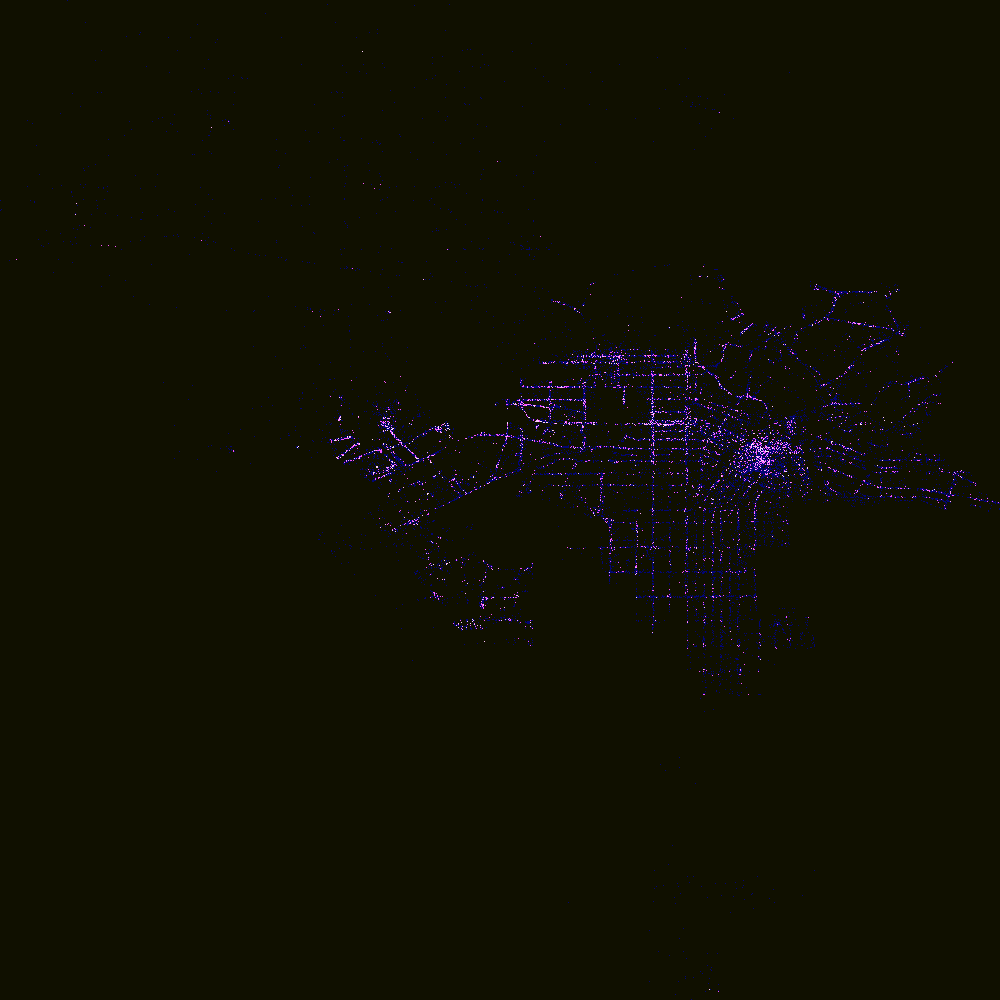

In [10]:
df['outlier_x'] = pd.qcut(df.X, 100, labels=False)
df['outlier_y'] = pd.qcut(df.Y, 100, labels=False)


for i in np.arange(1, 10):
    df = df[(df['X']!=df['X'].min()) & (df['Y']!=df['Y'].min())]
    df = df[(df['X']!=df['X'].max()) & (df['Y']!=df['Y'].max())]

range_x = (df['X'].min(), df['X'].max())
range_y = (df['Y'].min(), df['Y'].max())

wi = int(3000)
hi = int(3000)

cvs = ds.Canvas(plot_width=wi, plot_height=hi, x_range=range_x, y_range=range_y)
agg = cvs.points(df, "X", "Y", agg=ds.count())
img = tf.shade(agg, cmap=palette['CET_L7'][20:], how="eq_hist")
img = tf.spread(img, px=1, how='saturate')
img = tf.set_background(img, "#101000")

img

In [11]:
query = """
    SELECT longitude, latitude
    FROM `tidal-digit-291220.safegraph.places`
    WHERE city = 'Chicago' AND region = 'IL'
        """

In [12]:
df = bqclient.query(query).result().to_dataframe()

In [13]:
X, Y = lnglat_to_meters(df['longitude'], df['latitude'])

df['X'] = X
df['Y'] = Y

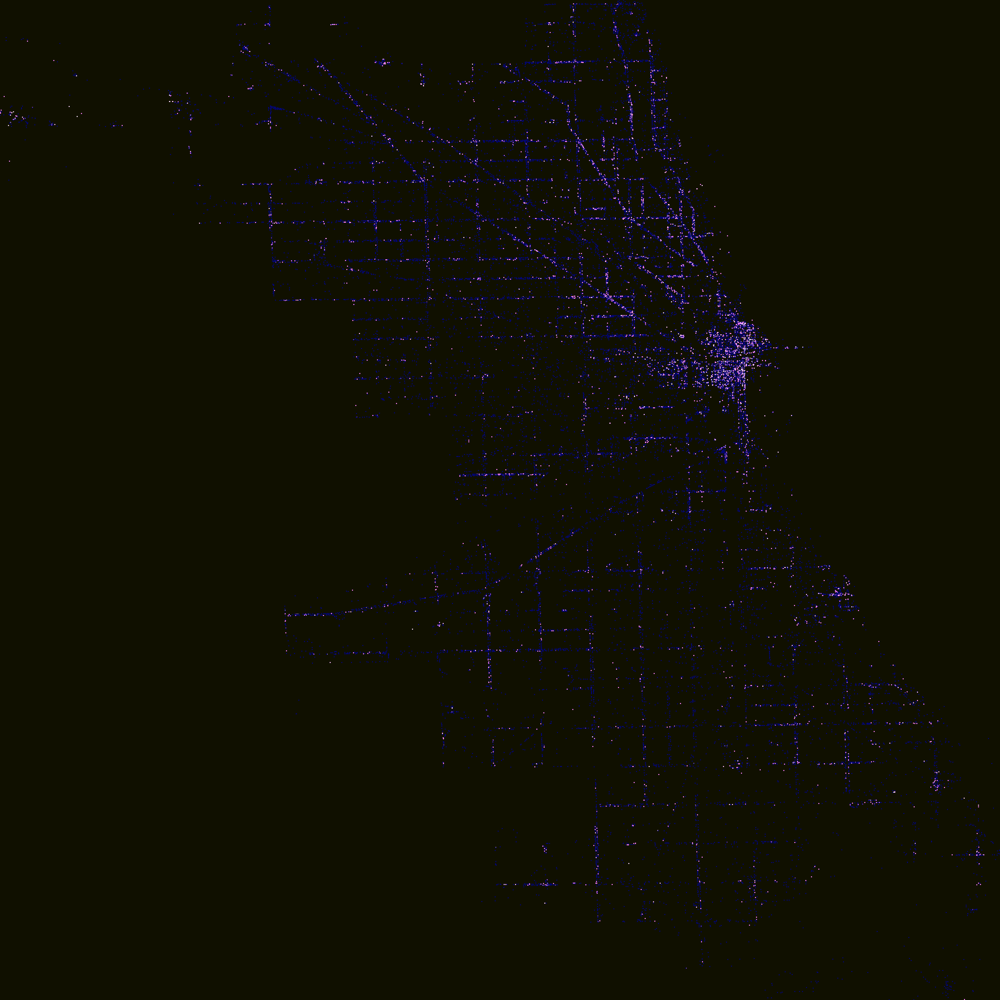

In [14]:
df['outlier_x'] = pd.qcut(df.X, 100, labels=False)
df['outlier_y'] = pd.qcut(df.Y, 100, labels=False)


for i in np.arange(1, 10):
    df = df[(df['X']!=df['X'].min()) & (df['Y']!=df['Y'].min())]
    df = df[(df['X']!=df['X'].max()) & (df['Y']!=df['Y'].max())]

range_x = (df['X'].min(), df['X'].max())
range_y = (df['Y'].min(), df['Y'].max())

wi = int(3000)
hi = int(3000)

cvs = ds.Canvas(plot_width=wi, plot_height=hi, x_range=range_x, y_range=range_y)
agg = cvs.points(df, "X", "Y", agg=ds.count())
img = tf.shade(agg, cmap=palette['CET_L7'][20:], how="eq_hist")
img = tf.spread(img, px=1, how='saturate')
img = tf.set_background(img, "#101000")

img

In [6]:
query = """
    SELECT poi_cbg, visitor_home_cbgs
    FROM `tidal-digit-291220.safegraph.2020_01`
    WHERE SUBSTR(CAST(poi_cbg AS STRING), 0, 5) = '36061' AND visitor_home_cbgs != '{}'
        """

In [7]:
raw = bqclient.query(query).result().to_dataframe()

In [7]:
import json

In [8]:
unnest = pd.json_normalize(raw.visitor_home_cbgs.apply(json.loads)).reset_index()
melted = unnest.melt(id_vars='index', var_name='visitor_home_cbgs', value_name='visits')

In [9]:
melted = melted.dropna()

In [10]:
joined = raw.reset_index().drop('visitor_home_cbgs', axis=1).merge(melted, 
                                                                   left_on='index', 
                                                                   right_on='index', 
                                                                   how='right').drop('index', axis=1)

In [11]:
joined = joined.dropna()

joined['poi_cbg'] = joined['poi_cbg'].astype('int64')
joined['visitor_home_cbgs'] = joined['visitor_home_cbgs'].astype('int64')

In [12]:
joined = joined.rename(columns={'poi_cbg': 'focal', 
                                'visitor_home_cbgs': 'target', 
                                'visits': 'weight'})

In [13]:
import cenpy

/Users/andrewrenninger/anaconda3/envs/sandbox/lib/python3.8/site-packages/fuzzywuzzy/fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')


In [14]:
acs = cenpy.remote.APIConnection("ACSDT5Y2018")
acs.set_mapservice("tigerWMS_ACS2018")

Connection to American Community Survey: 1-Year Estimates: Detailed Tables 5-Year(ID: https://api.census.gov/data/id/ACSDT5Y2018)
With MapServer: Census Current (2018) WMS

In [15]:
state = "36"
boros = ["061", "085", "047", "005", "081"]

counties = list()

for boro in boros:
    
    where_clause = f"STATE = {state} AND COUNTY = {boro}"
    block_groups = acs.mapservice.layers[10].query(where=where_clause)
    
    counties.append(block_groups)

blocks = gpd.GeoDataFrame(pd.concat(counties, ignore_index=True))

/Users/andrewrenninger/anaconda3/envs/sandbox/lib/python3.8/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


In [17]:
blocks = blocks.to_crs(3857)

In [18]:
nodes = pd.DataFrame({'X': blocks.centroid.x,
                      'Y': blocks.centroid.y,
                      'cbg': blocks.GEOID.astype('int64')}).set_index('cbg')

nodes.head()

,X,Y
cbg,,
360610138001,-8.232528e+06,4.979463e+06
360610255000,-8.232108e+06,4.989726e+06
360610261004,-8.230189e+06,4.989905e+06
360610261007,-8.230398e+06,4.989344e+06
360610273004,-8.230629e+06,4.990460e+06


In [19]:
edges = joined[joined['target'].isin(blocks['GEOID'])]
edges = edges.groupby(['focal', 'target']).weight.sum().reset_index()
edges = edges[edges['weight']>10]

edges.head()

,focal,target,weight
19,360610001001,360610007001,13.0
32,360610001001,360610076001,12.0
36,360610001001,360610084002,13.0
39,360610001001,360610090001,12.0
41,360610001001,360610092001,19.0


In [20]:
%%time
g1 = connect_edges(nodes, edges,
                   source='focal', target='target',
                   x='X', y='Y')

CPU times: user 461 ms, sys: 20.9 ms, total: 482 ms
Wall time: 483 ms


In [21]:
%%time
g2 = hammer_bundle(nodes, edges,
                   source='focal', target='target',
                   decay=0.25,
                   x='X', y='Y')

CPU times: user 12.7 s, sys: 9.76 s, total: 22.4 s
Wall time: 14.7 s


Unbundled,Bundled

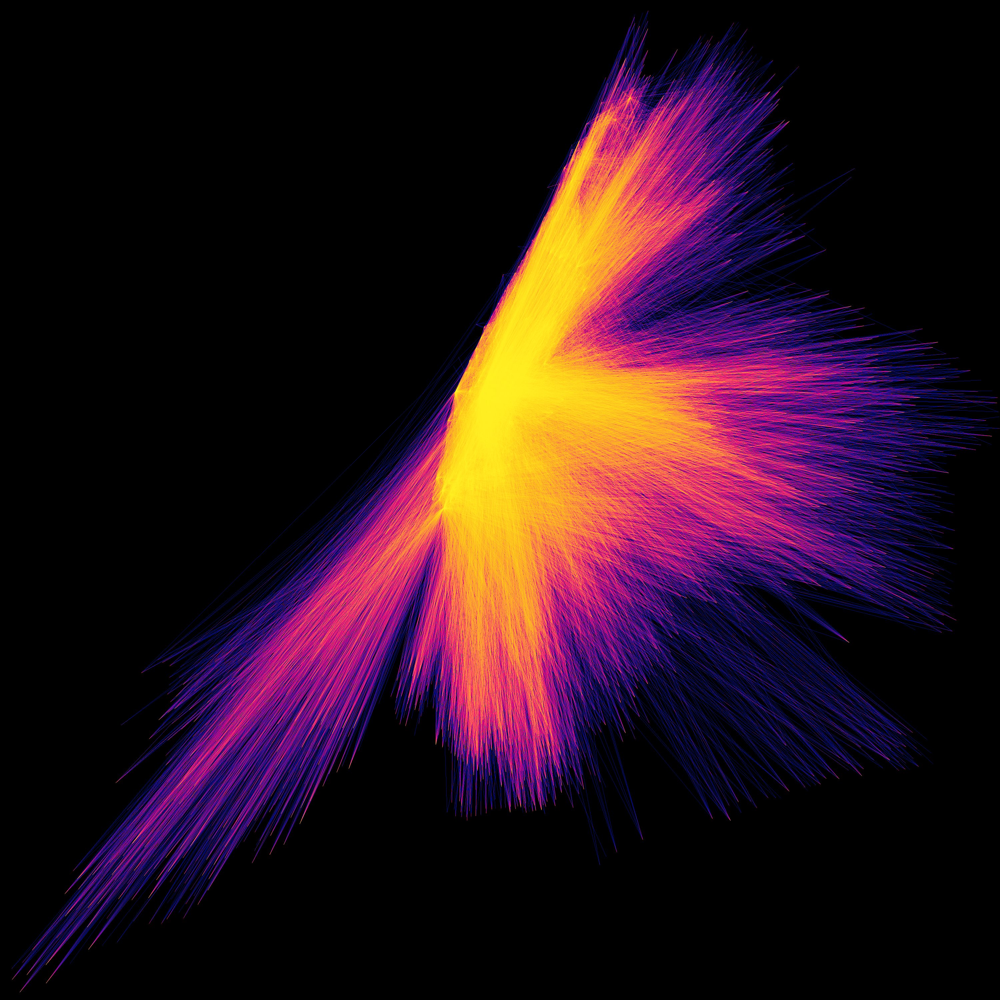
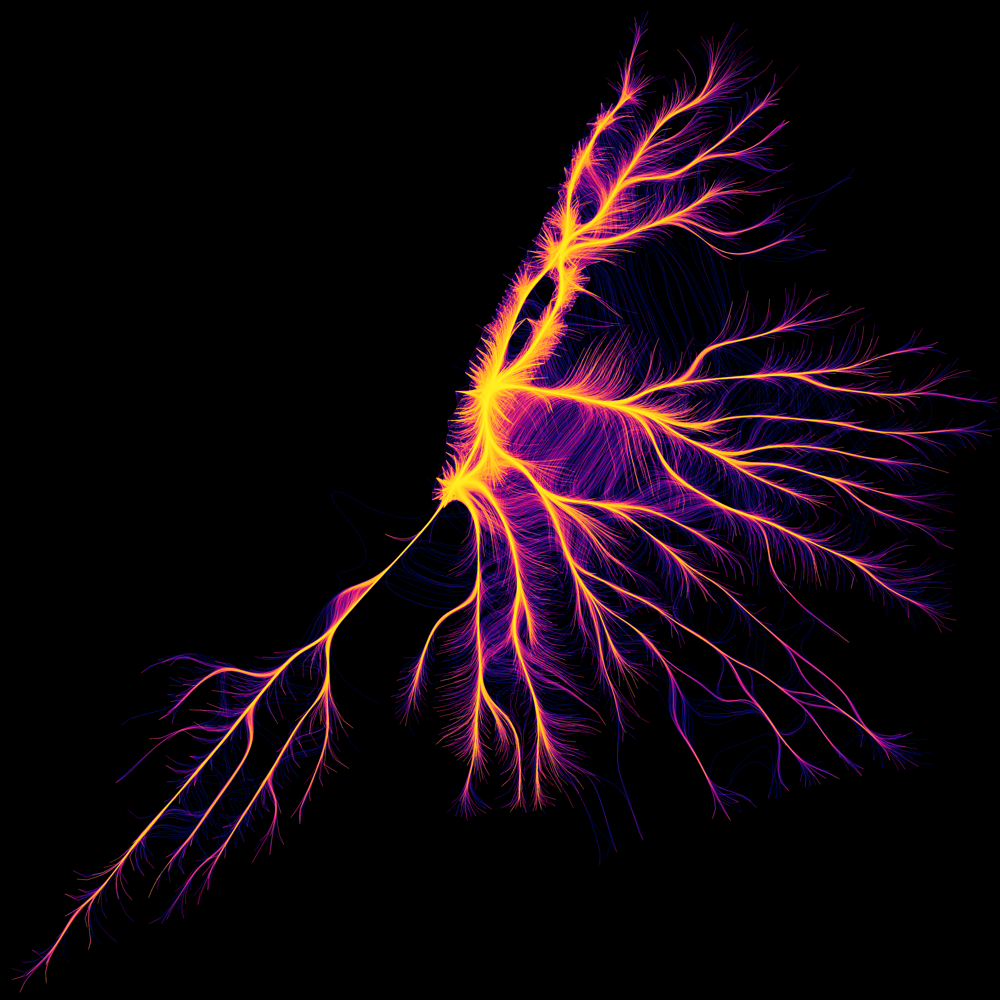

In [22]:
canvas = ds.Canvas(x_range=(nodes['X'].min(), nodes['X'].max()),
                   y_range=(nodes['Y'].min(), nodes['Y'].max()),
                   plot_height=3000, plot_width=3000)


p1 = tf.shade(canvas.line(g1, 'X', 'Y', agg=ds.count()),  cmap=palette['bmy'], how='eq_hist', name="Unbundled")

canvas = ds.Canvas(x_range=(nodes['X'].min(), nodes['X'].max()),
                   y_range=(nodes['Y'].min(), nodes['Y'].max()),
                   plot_height=3000, plot_width=3000)

p2 = tf.shade(canvas.line(g2, 'X','Y', agg=ds.count()), cmap=palette['bmy'], how='eq_hist', name="Bundled")

tf.Images(tf.set_background(p1, "#000000"), tf.set_background(p2, "#000000")).cols(2)

In [3]:
def get_nodes(fips):
    
    state = fips[:2]
    county = fips[2:]
        
    where_clause = f"STATE = {state} AND COUNTY = {county}"
    block_groups = acs.mapservice.layers[10].query(where=where_clause)
    
    block_groups = block_groups.to_crs(3857)
    
    nodes = pd.DataFrame({'X': block_groups.centroid.x,
                          'Y': block_groups.centroid.y,
                          'cbg': block_groups.GEOID.astype('int64')}).set_index('cbg')
    
    return nodes

In [4]:
def get_edges(fips, month, cbgs):
    
    job_config = bigquery.QueryJobConfig(
        query_parameters=[
            bigquery.ScalarQueryParameter("fips", "STRING", fips),
            bigquery.ScalarQueryParameter("month", "STRING", month),
        ]
    )
    
    query = f"""
        SELECT poi_cbg, home_cbg, sum(visits) as visits
        FROM (SELECT 
                lpad(CAST(poi_cbg AS STRING), 12, '0') as poi_cbg, 
                REGEXP_EXTRACT(unnested, '(.*?):') as home_cbg, 
                CAST(REGEXP_EXTRACT(unnested, ':(.*)') AS NUMERIC) as visits
              FROM `tidal-digit-291220.safegraph.2020_{month}`
              CROSS JOIN UNNEST(SPLIT(regexp_replace(REPLACE(REPLACE(visitor_home_cbgs, '{{', ''), '}}', ''), '\\"', ''))) as unnested
              WHERE SUBSTR(lpad(CAST(poi_cbg AS STRING), 12, '0'), 0, 5) = @fips AND visitor_home_cbgs != '{{}}')
        GROUP BY poi_cbg, home_cbg
            """
    
    resp = bqclient.query(query, job_config=job_config)
    data = resp.to_dataframe()
    
    edges = data.rename(columns={'poi_cbg': 'focal', 
                                 'home_cbg': 'target', 
                                 'visits': 'weight'})

    edges['focal'] = edges['focal'].astype('int64')
    edges['target'] = edges['target'].astype('int64')
    edges['weight'] = edges['weight'].astype('int64')

    edges = edges[edges['target'].isin(cbgs)]
    edges = edges[edges['weight']>10]
    
    return edges

In [5]:
def get_graph(edges, nodes, method='direct'):
    if method == 'bundled':
        print('Bundling desire lines...')
        return hammer_bundle(nodes, edges,
                             source='focal', target='target',
                             decay=0.25,
                             x='X', y='Y')
    else:
        print('Linking desire lines...')
        return connect_edges(nodes, edges,
                             source='focal', target='target',
                             x='X', y='Y')

In [6]:
def composers(graph, nodes):
    canvas = ds.Canvas(x_range=(nodes['X'].min(), nodes['X'].max()),
                       y_range=(nodes['Y'].min(), nodes['Y'].max()),
                       plot_height=3000, plot_width=3000)


    agg = tf.shade(canvas.line(graph, 'X', 'Y', agg=ds.count()),  cmap=palette['bmy'], how='eq_hist')
    img = tf.set_background(agg, "#000000")
    
    return img

In [ ]:
nodes = get_nodes('42101')

nodes.head()

In [129]:
edges = get_edges('42101', '04', nodes.reset_index()['cbg'])

edges.head()

,focal,target,weight
0,421010351001,421010351001,53
23,421010008042,421010331022,12
27,421010157001,421010157002,20
32,421010003001,421010004022,15
36,421010309003,421010309001,147


Linking desire lines...
Bundling desire lines...


,

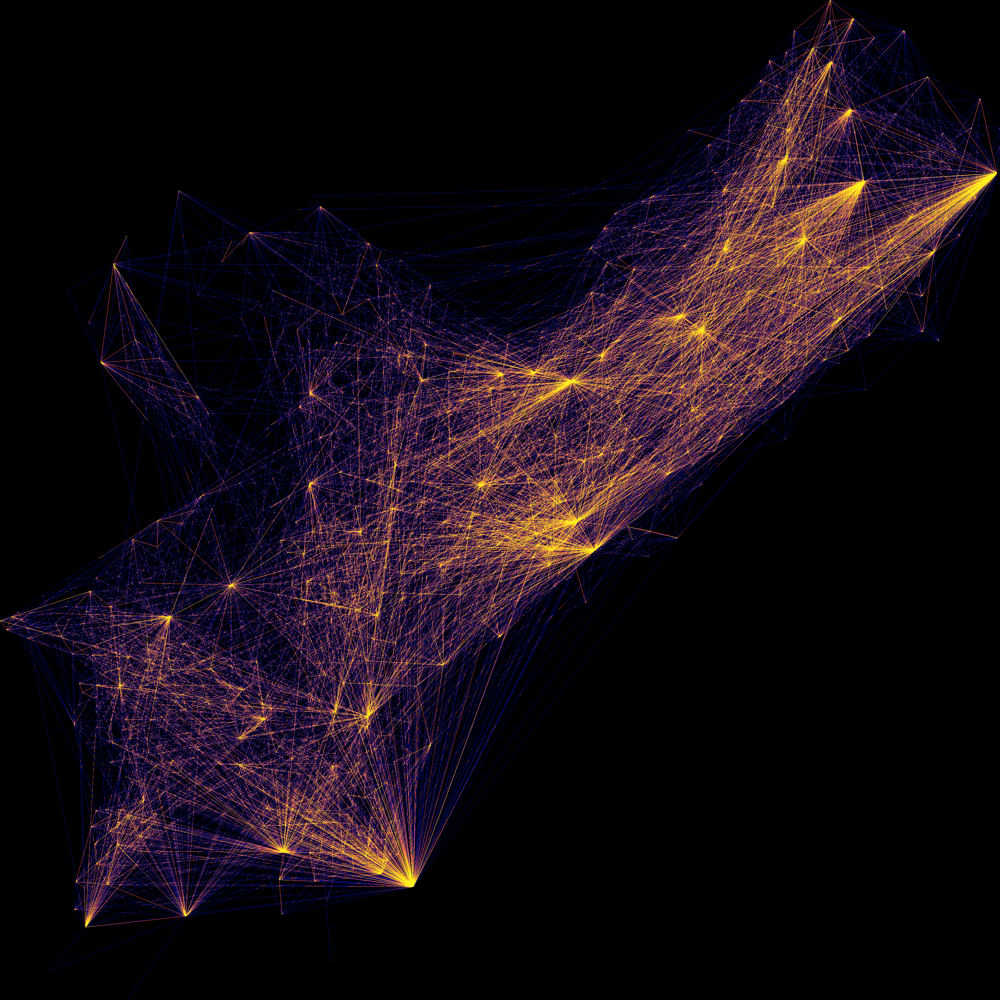
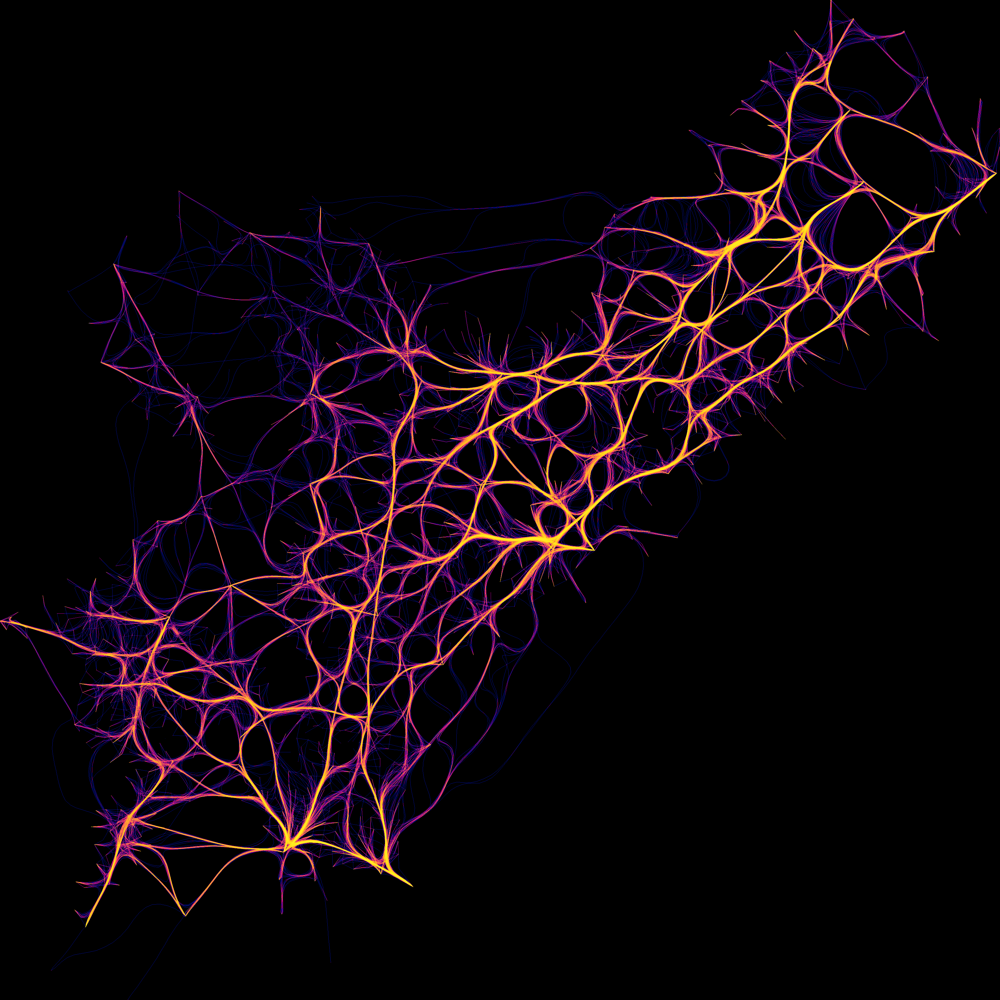

In [132]:
tf.Images(composers(get_graph(edges, nodes, method='direct'), nodes), 
          composers(get_graph(edges, nodes, method='bundled'), nodes)).cols(2)

In [155]:
nodes = get_nodes('06037')
nodes = nodes[(nodes.index!=60375991001) & (nodes.index!=60375991002)]

nodes.head()

/Users/andrewrenninger/anaconda3/envs/sandbox/lib/python3.8/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


,X,Y
cbg,,
60375417001,-1.315877e+07,4.017264e+06
60374074001,-1.313100e+07,4.035835e+06
60374076011,-1.312950e+07,4.034050e+06
60374075022,-1.312873e+07,4.034115e+06
60374076022,-1.312975e+07,4.032600e+06


In [156]:
edges = get_edges('06037', '04', nodes.reset_index()['cbg'])

edges.head()

,focal,target,weight
0,60371285002,60371282102,38
1,60371285002,60371288011,23
2,60371285002,60371284001,41
3,60371285002,60371289101,25
4,60371285002,60371289103,24


Linking desire lines...
Bundling desire lines...


,

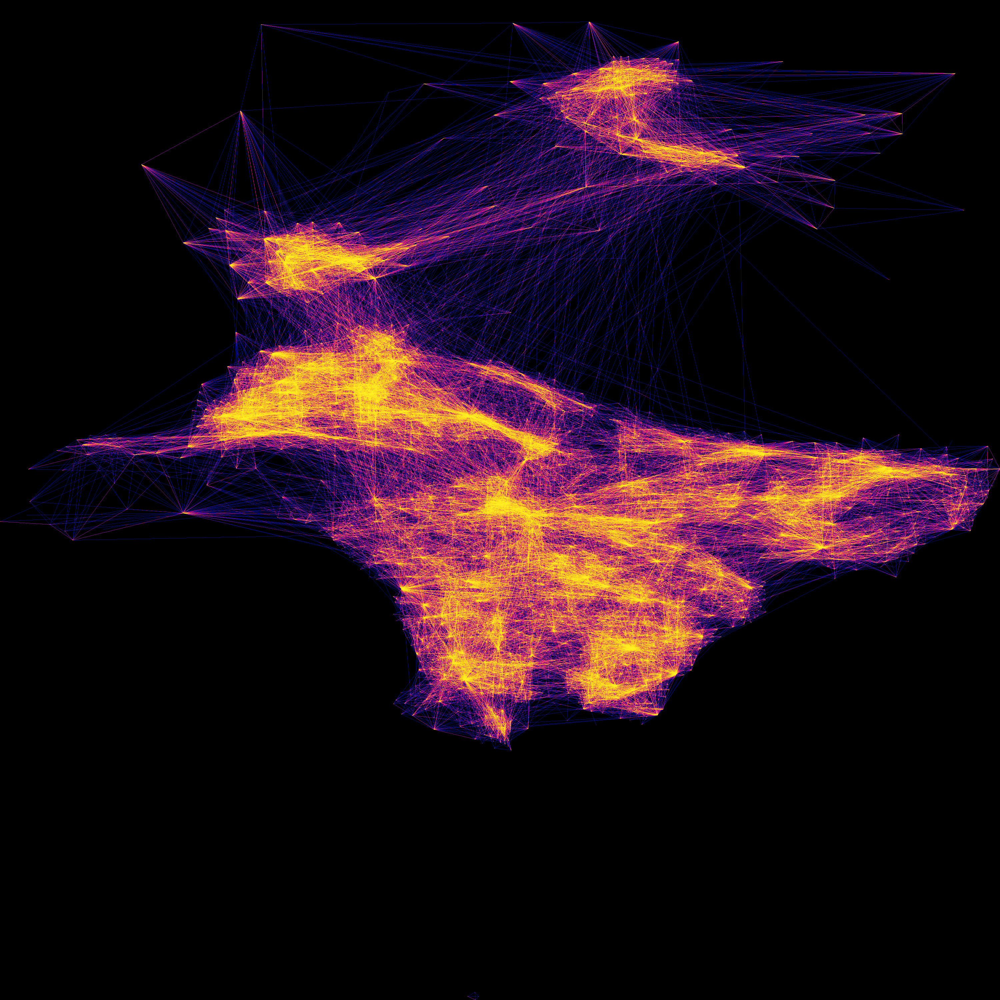
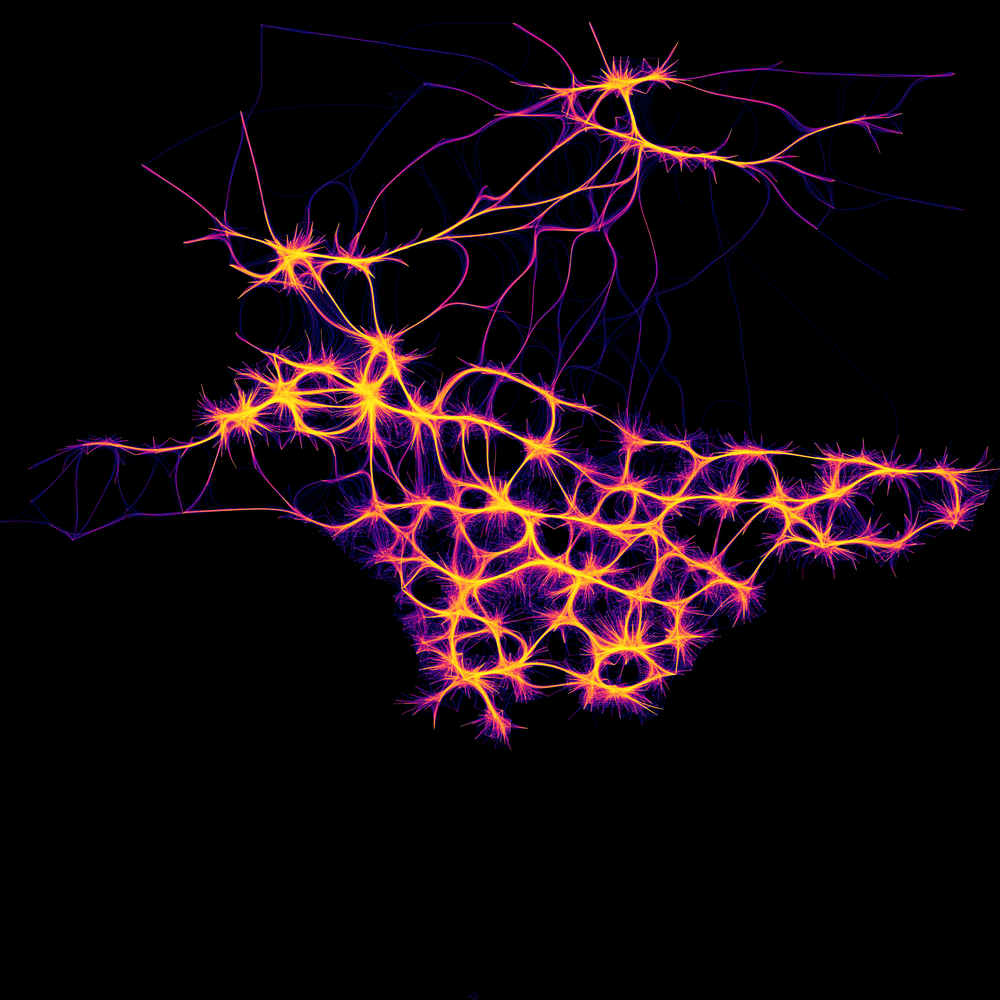

In [157]:
tf.Images(composers(get_graph(edges, nodes, method='direct'), nodes), 
          composers(get_graph(edges, nodes, method='bundled'), nodes)).cols(2)

In [158]:
nodes = get_nodes('17031')
nodes = nodes[(nodes.index!=60375991001) & (nodes.index!=60375991002)]

nodes.head()

/Users/andrewrenninger/anaconda3/envs/sandbox/lib/python3.8/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


,X,Y
cbg,,
170316501001,-9.764439e+06,5.128714e+06
170310208013,-9.762362e+06,5.158726e+06
170310208012,-9.762375e+06,5.159274e+06
170310209013,-9.761374e+06,5.160034e+06
170310209011,-9.761111e+06,5.160446e+06


In [159]:
edges = get_edges('17031', '04', nodes.reset_index()['cbg'])

edges.head()

,focal,target,weight
6,170318163004,170318113022,40
10,170318163004,170318164021,16
13,170318163004,170318163004,32
16,170318163004,170318163002,24
19,170318163004,170318163003,22


Linking desire lines...
Bundling desire lines...


,

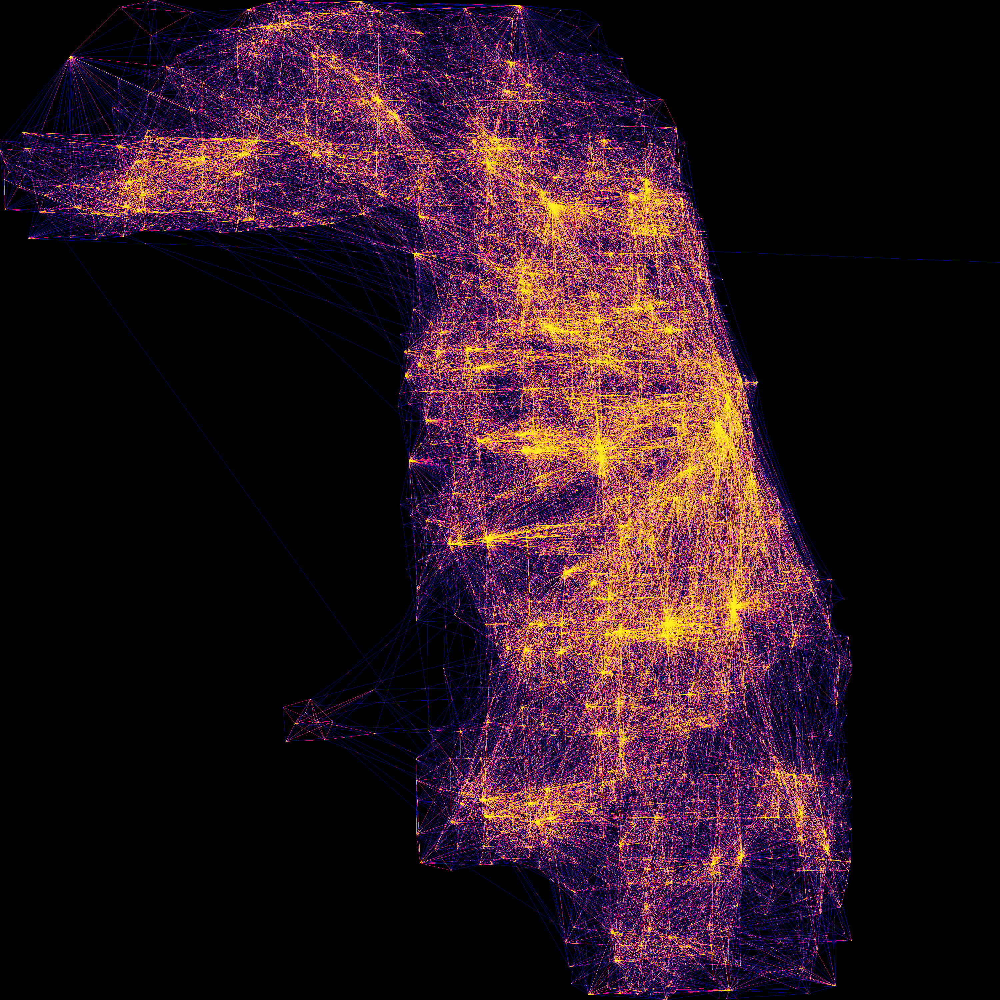
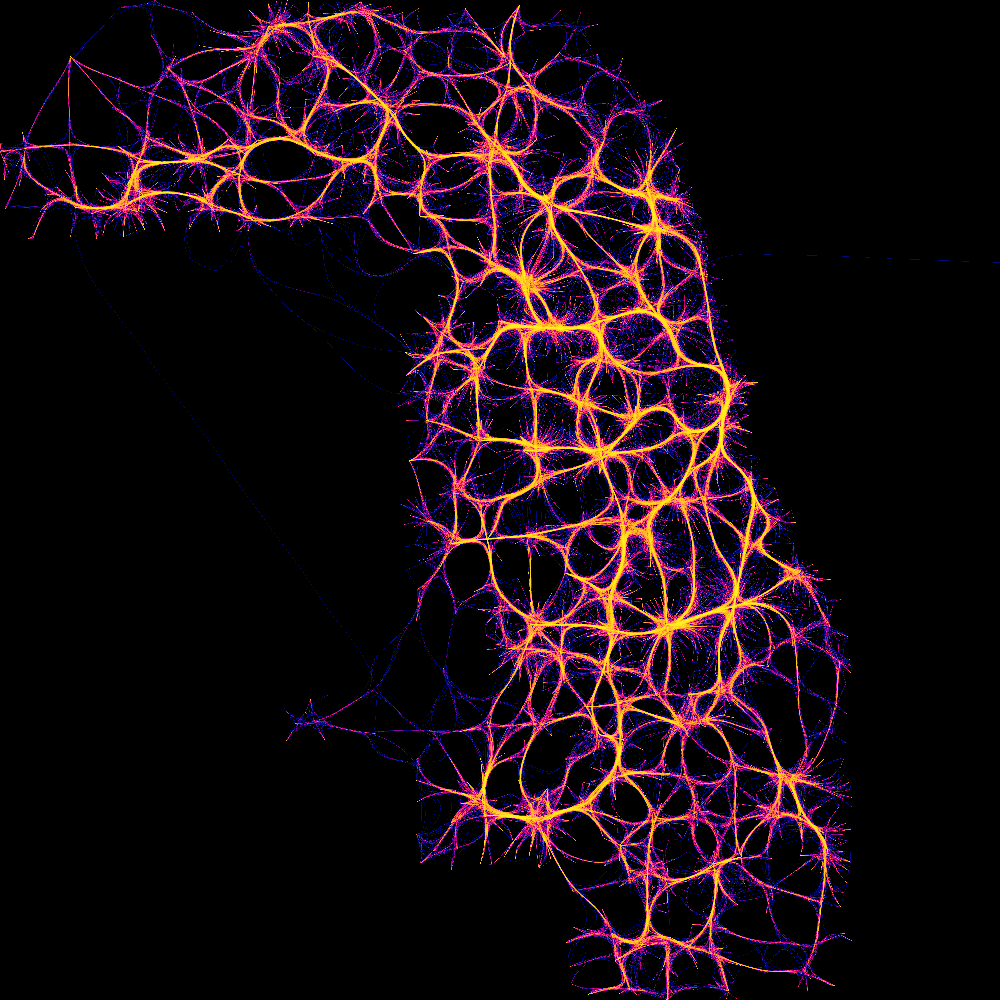

In [160]:
tf.Images(composers(get_graph(edges, nodes, method='direct'), nodes), 
          composers(get_graph(edges, nodes, method='bundled'), nodes)).cols(2)

In [173]:
islands = [60375991002, 60375990004, 60375990003, 60375991001, 60375990002, 60375990001]

nodes = get_nodes('06037')
nodes = nodes[~nodes.index.isin(islands)]

/Users/andrewrenninger/anaconda3/envs/sandbox/lib/python3.8/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


In [8]:
months = ["01", "02", "03", "04", "05", "06", "07", "08", "09"]

In [177]:
timeseries = list()

for month in months:
        
        temp = get_edges('06037', month, nodes.reset_index()['cbg'])
        temp['month'] = month
        
        timeseries.append(temp)

timeseries = pd.concat(timeseries, ignore_index=True)

In [7]:
def nodesplot(nodes):
    canvas = ds.Canvas(x_range=(nodes['X'].min(), nodes['X'].max()),
                       y_range=(nodes['Y'].min(), nodes['Y'].max()),
                       plot_height=3000, plot_width=3000)
    
    agg = canvas.points(nodes,'X','Y',agg=None)
    spr = tf.spread(tf.shade(agg, cmap=palette['CET_L7'][20]), px=8)
    
    return spr

def edgesplot(nodes, edges):
    canvas = ds.Canvas(x_range=(nodes['X'].min(), nodes['X'].max()),
                       y_range=(nodes['Y'].min(), nodes['Y'].max()),
                       plot_height=3000, plot_width=3000)
    
    agg = canvas.line(edges, 'X','Y', agg=ds.count())
    spr = tf.shade(agg, cmap=palette['bmy'], how='eq_hist')
    
    return spr

def combiplot(nodes, edges):
    
    verts = nodesplot(nodes)
    links = edgesplot(nodes, edges)
    
    stack = tf.stack(verts, links)
    
    ready = tf.set_background(stack, '#000000')
    
    return ready.to_pil()

def plot_graphs_by_month(fig, data, nodes, month, x_range, y_range):
    
    temp = data[data['month']==month].drop('month', axis=1)
    
    graph = connect_edges(nodes, temp,
                          source='focal', target='target',
                          x='X', y='Y', weight='weight')

    img = combiplot(nodes, graph)

    plt.clf()
    ax = fig.gca()
    ax.imshow(img, extent=[x_range[0], x_range[1], y_range[0], y_range[1]], origin='upper')
    ax.set_axis_off()
    fig.subplots_adjust(left=0, right=1, top=1, bottom=0)
    fig.tight_layout()

    ax.text(
        0.05,
        0.05,
        "Origin-Destination Flows",
        color="white",
        weight='bold',
        fontsize=40,
        ha="left",
        transform=ax.transAxes,
    )
    
    months = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September']
    
    ax.text(
        0.05,
        0.1,
        months[month-1],
        color="white",
        fontsize=40,
        ha="left",
        transform=ax.transAxes,
    )
    
    shape.plot(color='None', edgecolor='#ffffff', linewidth=0.25, alpha=0.5, ax=ax)

    fig.canvas.draw()
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype="uint8")
    image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))

    return image

In [178]:
state = '06'
county = '037'

where_clause = f"STATE = {state} AND COUNTY = {county}"
shape = acs.mapservice.layers[10].query(where=where_clause)
    
shape = shape.to_crs(3857)

/Users/andrewrenninger/anaconda3/envs/sandbox/lib/python3.8/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


In [219]:
islands = ['060375991002', '060375990004', '060375990003', '060375991001', '060375990002', '060375990001']

shape = shape[~shape.GEOID.isin(islands)]

In [193]:
timeseries['month'] = timeseries['month'].astype('int64')

In [200]:
import imageio

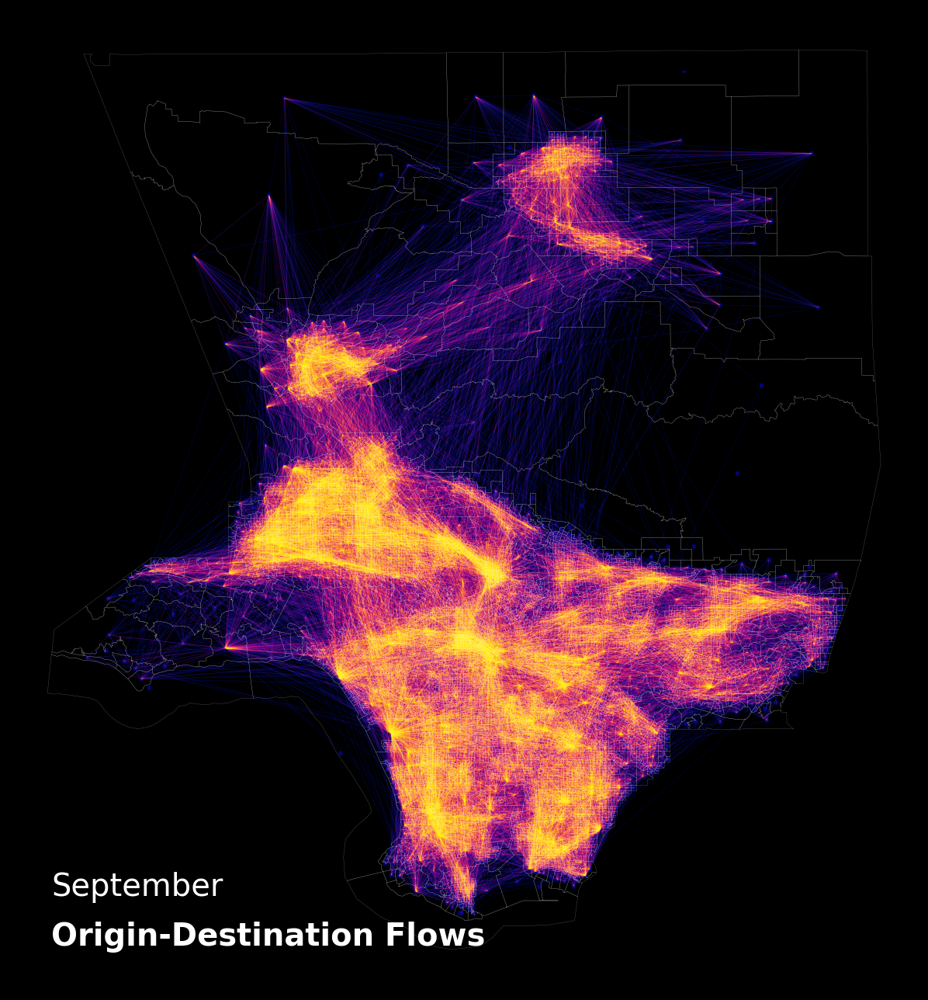

In [235]:
lac = [(nodes['X'].min(), nodes['X'].max()), (nodes['Y'].min(), nodes['Y'].max())]

fig, ax = plt.subplots(figsize=(18, 18), facecolor='black')

imgs = []

for period in np.sort(timeseries.month.unique()):
    
    img = plot_graphs_by_month(fig, timeseries, nodes, period, x_range=lac[0], y_range=lac[1])
    imgs.append(img)

imageio.mimsave('connections.gif', imgs, fps=1);

In [10]:
import cenpy

/Users/andrewrenninger/anaconda3/envs/sandbox/lib/python3.8/site-packages/fuzzywuzzy/fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')


In [11]:
acs = cenpy.remote.APIConnection("ACSDT5Y2018")
acs.set_mapservice("tigerWMS_ACS2018")

Connection to American Community Survey: 1-Year Estimates: Detailed Tables 5-Year(ID: https://api.census.gov/data/id/ACSDT5Y2018)
With MapServer: Census Current (2018) WMS

In [12]:
nodes = get_nodes('17031')
nodes = nodes[nodes.index!=170319900000]

/Users/andrewrenninger/anaconda3/envs/sandbox/lib/python3.8/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


In [13]:
months = ["01", "02", "03", "04", "05", "06", "07", "08", "09"]

In [14]:
timeseries = list()

for month in months:
        
        temp = get_edges('17031', month, nodes.reset_index()['cbg'])
        temp['month'] = month
        
        timeseries.append(temp)

timeseries = pd.concat(timeseries, ignore_index=True)

In [15]:
state = '17'
county = '031'

where_clause = f"STATE = {state} AND COUNTY = {county}"
shape = acs.mapservice.layers[10].query(where=where_clause)
    
shape = shape.to_crs(3857)

/Users/andrewrenninger/anaconda3/envs/sandbox/lib/python3.8/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


In [24]:
shape = shape[shape.GEOID!='170319900000']

In [16]:
timeseries['month'] = timeseries['month'].astype('int64')

In [17]:
import imageio

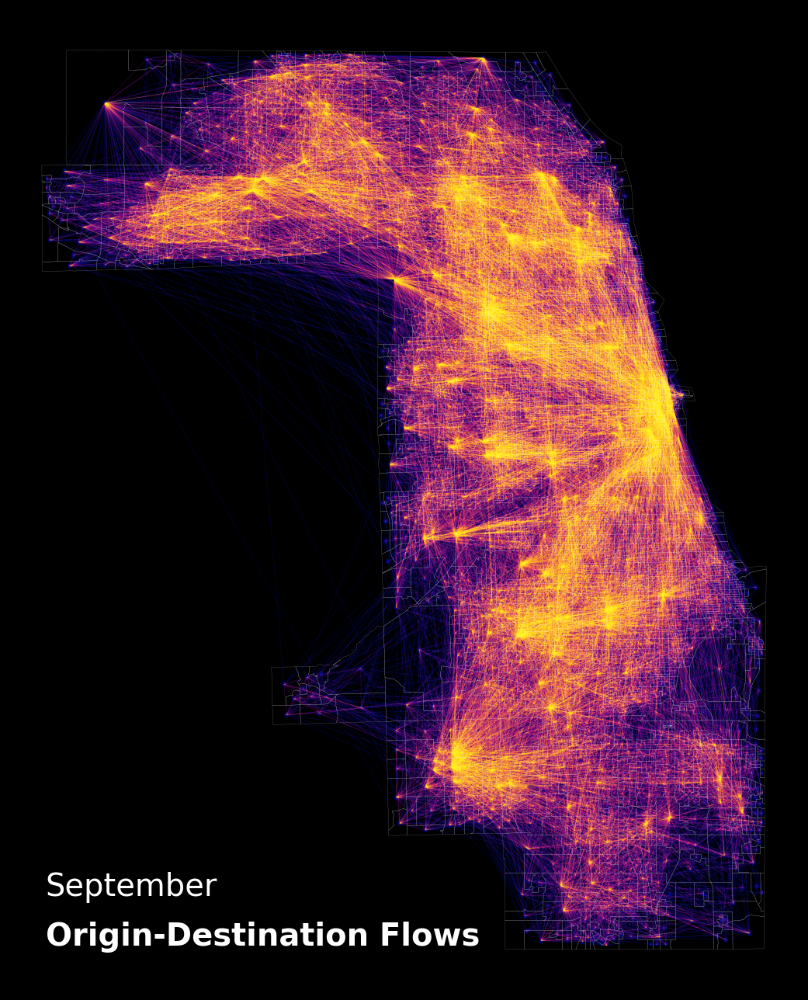

In [25]:
chi = [(nodes['X'].min(), nodes['X'].max()), (nodes['Y'].min(), nodes['Y'].max())]

fig, ax = plt.subplots(figsize=(18, 18), facecolor='black')

imgs = []

for period in np.sort(timeseries.month.unique()):
    
    img = plot_graphs_by_month(fig, timeseries, nodes, period, x_range=chi[0], y_range=chi[1])
    imgs.append(img)

imageio.mimsave('cook.gif', imgs, fps=1);